In [7]:
# general purpose
import pandas as pd
import numpy as np
import time
import scipy

# visualization tools
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
import plotly.express as px

# manifold learning
from sklearn.manifold import TSNE

# standard clustering
import sklearn.cluster as cl
import sklearn.metrics as ms
from sklearn import metrics
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors
from sklearn import decomposition

# hdbscan
import hdbscan 

# For density validation
from DBCV import DBCV
from scipy.spatial.distance import euclidean
# From local files
from density_functions import pre_processing, clustering_dbscan, find_best_min_samples, best_eps, plotting_two_vars
import yaml

# Introduzione

Uso questo notebook come base di partenza per i vari script presenti in questa cartella. Niente al suo interno può essere considerato *production ready*.

Facendo diversti tentativi, ho notato dei pattern interessanti. In particolar modo, rispetto al KMeans, a "occhio", i cluster sembrano più sensati, s

In [2]:
print("-- Loading config file")
with open("../density_based_clustering/config.yml", "r") as file:
    load_vars = yaml.safe_load(file)
print("-- Pre-processing")
df_person_var, df_current_investment = pre_processing()

# Standardize the variables
# Some have already decent values, while others do not.
X = StandardScaler().fit_transform(df_person_var[load_vars["clustering_variables"]])

-- Loading config file
-- Pre-processing


# HDBSCAN

In [3]:
clusterer = hdbscan.HDBSCAN(metric = "euclidean", 
                            gen_min_span_tree=True,
                            min_cluster_size=60, 
                            min_samples=7).fit(X)

In [4]:
print("Final number of clusters found", clusterer.labels_.max()+1)

Final number of clusters found 4


In [ ]:
clusterer.minimum_spanning_tree_.plot(edge_cmap='viridis',
                                      edge_alpha=0.6,
                                      node_size=80,
                                      edge_linewidth=2)

In [ ]:
clusterer.single_linkage_tree_.plot(cmap='viridis', colorbar=True)

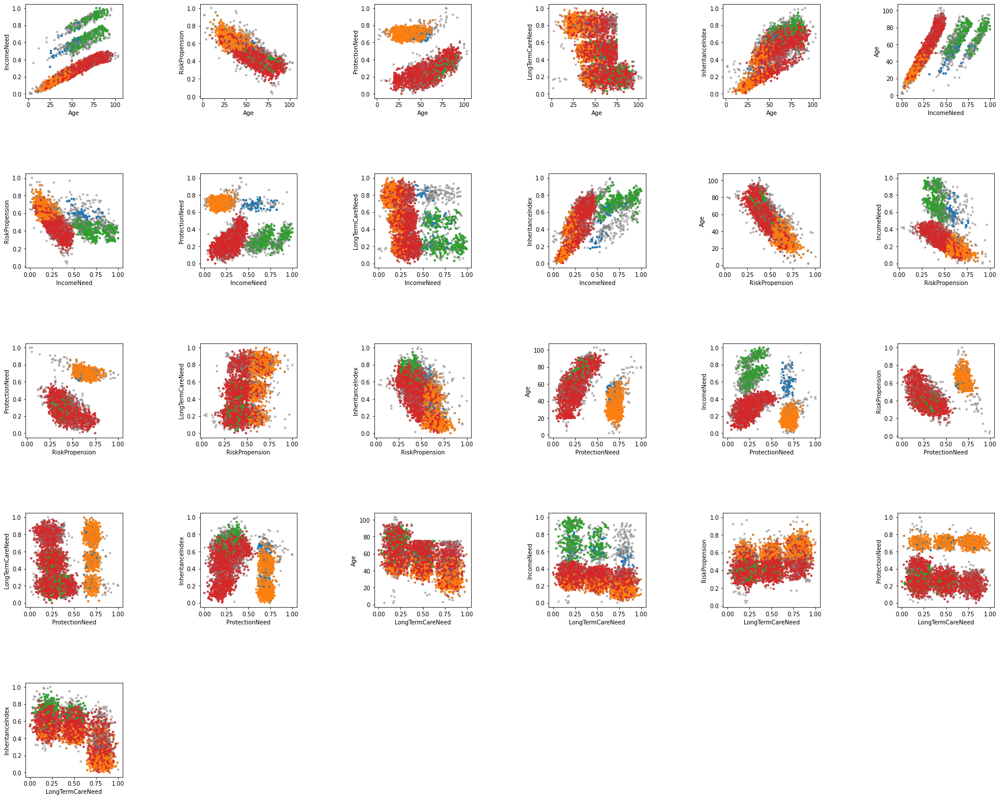

In [5]:
# I use this variable for the subplot 
fig = plt.figure(figsize = (30, 30))
fig.subplots_adjust(hspace=0.8, wspace=0.8)
i = 0
for colname1 in load_vars["clustering_variables"][:5]:
    for colname2 in load_vars["clustering_variables"]:        
        if colname1 == colname2:
            pass
        else:
            i += 1
        
            palette = sns.color_palette()
            cluster_colors = [sns.desaturate(palette[col], sat)
                            if col >= 0 else (0.5, 0.5, 0.5, 0.5) 
                            for col, sat in zip(clusterer.labels_, clusterer.probabilities_)]
            ax = plt.subplot(6, 6, i)
            ax.scatter(df_person_var[colname1], 
                        df_person_var[colname2], 
                        c=cluster_colors, 
                        marker='.')
            plt.xlabel(colname1)
            plt.ylabel(colname2)
plt.show()

In [9]:
X_transformed

array([[-75.74916 , -19.512657],
       [ 22.995602, -56.18758 ],
       [-43.679176,  51.13711 ],
       ...,
       [-11.510223,  70.742294],
       [ -6.177676, -10.515474],
       [-76.51576 , -25.54733 ]], dtype=float32)

ValueError: 'c' argument has 5000 elements, which is inconsistent with 'x' and 'y' with size 6.

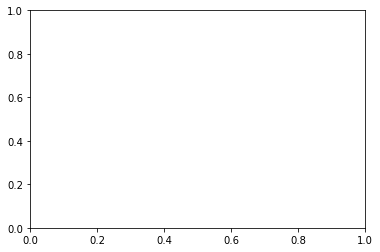

In [8]:
N_projection = 2
# Transform using Manifold Learning
X_transformed = TSNE(n_components = N_projection).fit_transform(X)
# 
palette = sns.color_palette()
cluster_colors = [sns.desaturate(palette[col], sat)
                if col >= 0 else (0.5, 0.5, 0.5) 
                for col, sat in zip(clusterer.labels_, clusterer.probabilities_)]
plt.scatter(X_transformed[:,0], 
            X_transformed[:,1], 
            c=cluster_colors, 
            marker='.')
plt.title("TSNE Manifold projection for the clustering")
plt.xlabel("X₁")
plt.ylabel("X₂")
plt.savefig("TSNE"+str(cluster_name)+".pdf")
plt.show()



# K Means

In [80]:
clusters_Kmeans = cl.KMeans(n_clusters = 4, 
          n_init=int(1e2), 
          init='k-means++',
         max_iter=int(1e3),
         tol=1e-3,
         verbose=False,
         ).fit_predict(X)

In [70]:
# Eliminate non clustered points (noise points)
X_score = X[np.where(clusterer.labels_ > 0)]
labels_score = clusterer.labels_[np.where(clusterer.labels_ > 0)]

print("Silhouette KMeans", ms.silhouette_score(X, clusters_Kmeans, metric='euclidean'))
print("Silhouette HDBSCAN", ms.silhouette_score(X_score, labels_score, metric='euclidean'))

Silhouette KMeans 0.294541789676244
Silhouette HDBSCAN 0.2825863130301959


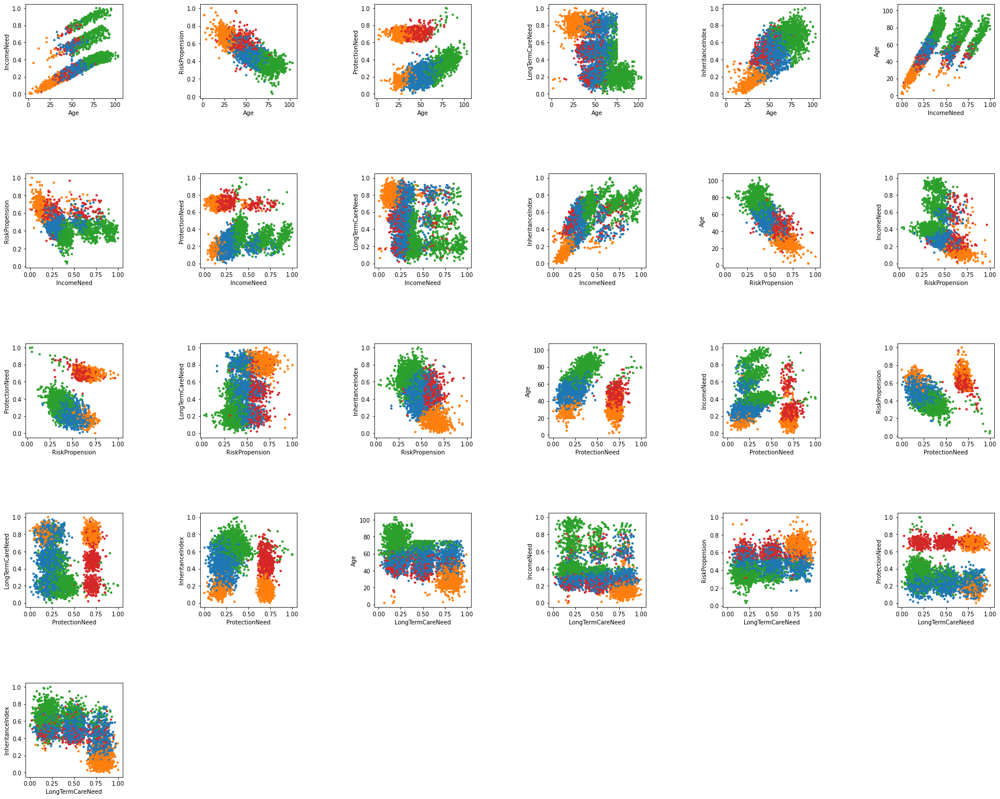

In [81]:
# I use this variable for the subplot 
fig = plt.figure(figsize = (30, 30))
fig.subplots_adjust(hspace=0.8, wspace=0.8)
i = 0
for colname1 in load_vars["clustering_variables"][:5]:
    for colname2 in load_vars["clustering_variables"]:        
        if colname1 == colname2:
            pass
        else:
            i += 1
        
            palette = sns.color_palette()
            cluster_colors = [sns.desaturate(palette[col], 1)
                            if col >= 0 else (0.5, 0.5, 0.5) 
                            for col in clusters_Kmeans]
            ax = plt.subplot(6, 6, i)
            ax.scatter(df_person_var[colname1], 
                        df_person_var[colname2], 
                        c=cluster_colors, 
                        marker='.')
            plt.xlabel(colname1)
            plt.ylabel(colname2)
plt.show()

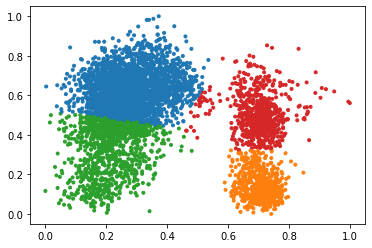

In [26]:
palette = sns.color_palette()
cluster_colors = [sns.desaturate(palette[col], 1)
                  if col >= 0 else (0.5, 0.5, 0.5) 
                  for col in clusters_Kmeans]
plt.scatter(df_person_var["ProtectionNeed"], 
            df_person_var["InheritanceIndex"], 
            c=cluster_colors, 
            marker='.')